In [1]:
import numpy as np
import matplotlib.pyplot as plt
import librosa as lb
import librosa.display

import IPython.display as ipd

In [2]:
# song, sr = lb.load("oxas.wav", sr=44e3)
# song,sr = lb.load("middle.wav",sr=44e3)
song,sr = lb.load("do_it_to_it.mp3",sr=44e3)
# song = song[:int(.1*len(song))]
song = (song*(2**15-1)).astype('int16')*1.0 # discretize

/home/avercruysse/.conda/envs/pytorch/lib/python3.9/site-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [3]:
ipd.Audio(song, rate=sr)

In [4]:
song

array([65., 78., 71., ...,  0.,  0.,  0.])

In [5]:
n_fft = 32
hop_length = 32
spec = np.abs(lb.stft(song, n_fft=n_fft, hop_length=hop_length))

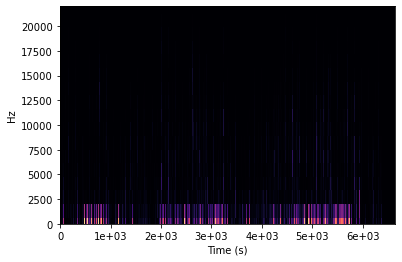

In [6]:
lb.display.specshow(spec, sr=sr, hop_length=1024, x_axis="s", y_axis="hz")

In [7]:
np.argmax(np.sum(spec, axis=0))

173585

In [8]:
def sample_generator(song, N=2, spec=None):
    if spec is None:
        n_fft = 32
        hop_length = 32
        spec = np.abs(lb.stft(song, n_fft=n_fft, hop_length=hop_length))
    for i in range(N, spec.shape[1]):
        yield spec[:,i-N+1:i+1].T[::-1]

In [9]:
def spectral_first_diff(x, bin=5):
    return x[0, bin] - x[1, bin]

In [10]:
y = []
for samples in sample_generator(song):
    y.append(spectral_first_diff(samples))

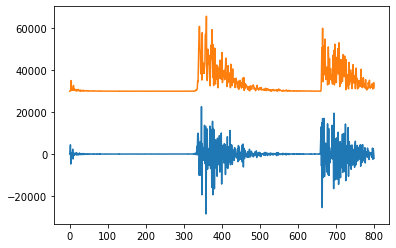

In [11]:
plt.plot(y[:800])
plt.plot(spec[5, :800] + 3e4)

In [12]:
def rec(x):
    x[x<0] = 0
    return x 

def spectral_novelty(x):
    return np.sum(rec(x[0]) - rec(x[1]))

In [13]:
def test_fn(fn, song, spec=None):
    y = []
    for samples in sample_generator(song):
        y.append(fn(samples))
    plt.plot(y[:800])
    if spec is not None:
        plt.plot(spec[5, :800] + 3e4)

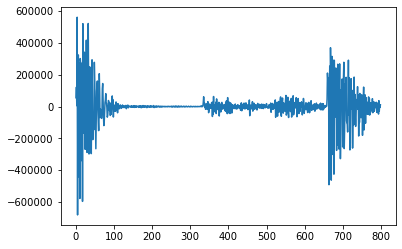

In [14]:
test_fn(spectral_novelty, song)

In [15]:
taps = [
    -0.000000000000000002,
    0.003231421245382224,
    0.015181099414059504,
    0.039956971075327488,
    0.077885504852263768,
    0.121497062505475525,
    0.156934840661739905,
    0.170626200491503066,
    0.156934840661739960,
    0.121497062505475539,
    0.077885504852263809,
    0.039956971075327571,
    0.015181099414059516,
    0.003231421245382219,
    -0.000000000000000002,
]

def low_pass(x):
    return np.sum([x[i]*taps[i] for i in range(15)])

In [16]:
y = []
for samples in sample_generator(song):
    y.append(spectral_novelty(samples))
res = []
for samples in sample_generator(None, spec=np.array(y)[None,:], N=15):
    res.append(low_pass(samples))

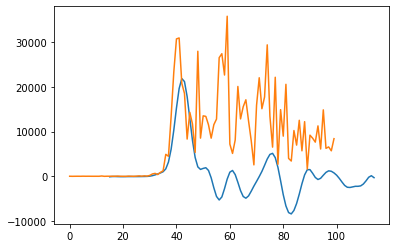

In [17]:
plt.plot(np.arange(15, 115), res[300:400])
plt.plot(spec[5, 300:400] + 3e0)

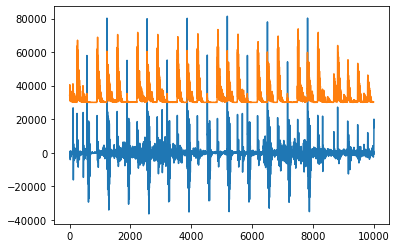

In [18]:
a = int(1e4)
l = 1e4

b = int(a+l)
plt.plot(np.arange(15, l+15), res[a:b])
plt.plot(spec[5, a:b] + 3e4)

In [19]:
# s = 1e4 # 1E4 for do it do it
thresh = 2e4 # 1e4 for do it to it
s = thresh
bins = list(range(10, 17))
print(bins)
def debounced_thresh(X, bins=bins):
    wait = 30 # ~200 bpm max
    if "last" not in debounced_thresh.__dict__:
        debounced_thresh.last = wait  # will override
        debounced_thresh.over = False  # will override
    if np.sum(X[0, np.array(bins)]) > thresh:
        if debounced_thresh.over == True:
            debounced_thresh.last = 0  # reset hysteresis
            return s*2 - (s*2/wait * debounced_thresh.last) # debug!!
        else:
            if debounced_thresh.last > wait:
                debounced_thresh.last = 0  # reset hysteresis
                debounced_thresh.over = True
                return int(s*3)
            else:
                debounced_thresh.last = 0  # reset hysteresis
                # debounced_thresh.last += 1
                return s*2 - (s*2/wait * debounced_thresh.last) # debug!!
    else:
        if debounced_thresh.last > wait:
            debounced_thresh.over = False
            return 0
        else:
            debounced_thresh.last += 1
            return s*2 - (s*2/wait * debounced_thresh.last) # debug!!


[10, 11, 12, 13, 14, 15, 16]


    if debounced_tresh.over == True:
        if debounced_thresh.last < wait:
        elif np.sum(X[0, np.array(bins)]) > thresh:
            debounced_thresh.last = 0

    if debounced_thresh.last < wait:
        debounced_thresh.last += 1
        return 2e4 - (2e4/wait * debounced_thresh.last) # debug!!
        # return 0
    elif np.sum(X[0, np.array(bins)]) > thresh:
        debounced_thresh.last = 0
        return int(2e4)
    return 0

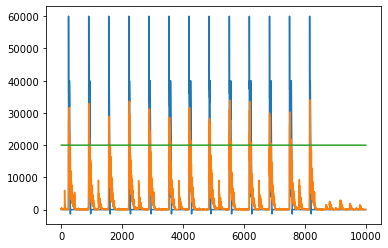

In [20]:
a =  int(1e4) # int(15e3)
l =  1e4

b = int(a+l)
y = []
for samples in sample_generator(song, N=1):
    y.append(debounced_thresh(samples))
y = np.array(y)
plt.plot(y[a:b])
# bins = [5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
spec_summed = np.sum(spec[np.array(bins), :], axis=0)
plt.plot(spec_summed[a:b])
plt.plot(np.ones(int(l))*thresh)

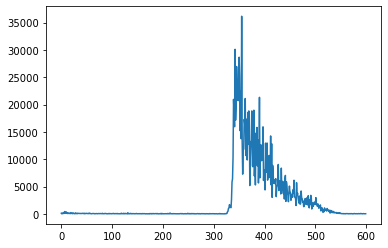

In [28]:
plt.plot(spec_summed[0:600])

In [22]:
beats = np.where(y==int(3*s))

In [23]:
beats

(array([   338,   1001,   1661,   2318,   2981,   3641,   4301,   4958,
          5621,   6278,   6941,   7598,   8258,   8918,   9579,  10238,
         10901,  11558,  12221,  12878,  13541,  14201,  14859,  15521,
         16178,  16841,  17498,  18158,  22109,  22769,  23100,  23430,
         24089,  24420,  24749,  25409,  25740,  26069,  26729,  27060,
         27389,  28049,  28380,  28710,  29369,  29700,  30029,  30689,
         31020,  31349,  32009,  32340,  32669,  33329,  33660,  33990,
         34649,  34980,  35309,  35969,  36300,  36629,  37289,  37949,
         38609,  38940,  39270,  39929,  40589,  41250,  41910,  42577,
         43237,  43897,  44557,  45217,  45877,  46537,  47197,  47857,
         48517,  49177,  49837,  50497,  51157,  51817,  52477,  53137,
         53797,  54457,  55117,  55777,  56437,  57763,  58423,  59088,
         59743,  60403,  61062,  61723,  62383,  63035,  63703,  64363,
         65024,  66343,  67003,  67663,  68327,  68983,  69643, 

In [24]:
clicks = lb.clicks(frames=beats, sr=sr, hop_length=32, length=len(song))

In [25]:
ipd.Audio(clicks + song/np.max(song), rate=sr)

In [26]:
song

array([65., 78., 71., ...,  0.,  0.,  0.])